In [ ]:
!pip install chart_studio
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt # data visualization
import seaborn as sns # statistical data visualization
from sklearn import metrics
import sklearn
from sklearn.preprocessing import scale
from sklearn import model_selection, preprocessing, feature_selection, ensemble, linear_model, metrics, decomposition
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, explained_variance_score, max_error
from sklearn.metrics import mean_poisson_deviance, mean_gamma_deviance, mean_absolute_percentage_error, d2_tweedie_score
from sklearn.metrics import confusion_matrix, classification_report,roc_curve,roc_auc_score,accuracy_score
from sklearn import model_selection
from sklearn.model_selection import KFold,train_test_split

#-- plotly
# from chart_studio import plotly
import chart_studio.plotly as py
from chart_studio import plotly
# import plotly.plotly as py
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
import plotly.graph_objs as go
import os
print(os.listdir("input"))

# Any results you write to the current directory are saved as output.

from pandas import read_excel
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
# %matplotlib inline

import scipy
import statsmodels.formula.api as smf
import statsmodels.api as sm



In [3]:
data = pd.read_csv('../Datasets/baseline.csv')
data.drop('SHA',axis=1,inplace=True)
data

,cbo,wmc,dit,rfc,lcom,totalMethods,totalFields,nosi,loc,returnQty,...,tryCatchQty,parenthesizedExpsQty,stringLiteralsQty,numbersQty,assignmentsQty,mathOperationsQty,variablesQty,maxNestedBlocks,uniqueWordsQty,defect
0,5,60,2,55,189,27,5,30,247,25,...,4,2,47,9,27,5,17,3,191,0
1,3,10,1,1,9,7,4,1,38,7,...,0,0,0,22,4,0,4,2,69,0
2,3,10,1,1,9,7,4,0,38,7,...,0,0,0,22,4,0,4,2,69,1
3,20,59,3,63,189,24,9,4,262,12,...,0,6,6,14,45,8,41,4,222,0
4,21,58,2,61,189,24,9,0,260,12,...,0,6,6,14,45,8,41,4,222,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6047,52,124,12,144,963,110,9,0,804,20,...,0,0,26,16,32,4,30,6,689,1
6048,24,27,2,46,4,8,8,0,126,3,...,0,1,3,14,27,0,24,3,108,0
6049,22,27,1,46,4,8,8,0,126,3,...,0,1,3,14,27,0,24,3,108,1
6050,3,12,2,12,28,8,0,1,67,7,...,2,0,0,2,10,0,8,2,36,0


In [ ]:
data.defect.value_counts()

0    3026
1    3026
Name: defect, dtype: int64

In [ ]:
data.info() #informs about the data (memory usage, data types etc.)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6052 entries, 0 to 6051
Data columns (total 22 columns):
 #   Column                Non-Null Count  Dtype
---  ------                --------------  -----
 0   cbo                   6052 non-null   int64
 1   wmc                   6052 non-null   int64
 2   dit                   6052 non-null   int64
 3   rfc                   6052 non-null   int64
 4   lcom                  6052 non-null   int64
 5   totalMethods          6052 non-null   int64
 6   totalFields           6052 non-null   int64
 7   nosi                  6052 non-null   int64
 8   loc                   6052 non-null   int64
 9   returnQty             6052 non-null   int64
 10  loopQty               6052 non-null   int64
 11  comparisonsQty        6052 non-null   int64
 12  tryCatchQty           6052 non-null   int64
 13  parenthesizedExpsQty  6052 non-null   int64
 14  stringLiteralsQty     6052 non-null   int64
 15  numbersQty            6052 non-null   int64
 16  assign

In [ ]:
data.shape #shows the number of rows and columns

(6052, 22)

In [ ]:
data.describe() #shows simple statistics (min, max, mean, etc.)

,cbo,wmc,dit,rfc,lcom,totalMethods,totalFields,nosi,loc,returnQty,...,tryCatchQty,parenthesizedExpsQty,stringLiteralsQty,numbersQty,assignmentsQty,mathOperationsQty,variablesQty,maxNestedBlocks,uniqueWordsQty,defect
count,6052.000000,6052.000000,6052.000000,6052.000000,6052.000000,6052.000000,6052.000000,6052.000000,6052.000000,6052.000000,...,6052.000000,6052.000000,6052.000000,6052.000000,6052.000000,6052.000000,6052.000000,6052.000000,6052.000000,6052.000000
mean,27.493721,86.177958,4.599141,68.954395,1242.030238,33.497852,14.049405,5.945142,442.074190,25.410112,...,3.218275,5.267845,36.727859,31.120621,65.899042,15.794118,49.700430,5.041143,219.283212,0.500000
std,33.214827,136.077153,9.288447,85.771623,9449.009245,53.556999,26.051029,25.263058,681.566084,47.058370,...,8.569417,13.956639,118.995663,85.715467,101.501174,40.011677,72.531059,5.920991,267.134701,0.500041
min,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,0.000000
25%,9.000000,18.000000,1.000000,18.000000,4.000000,8.000000,3.000000,0.000000,93.000000,4.000000,...,0.000000,0.000000,3.000000,2.000000,13.000000,1.000000,10.000000,2.000000,74.000000,0.000000
50%,18.000000,45.000000,2.000000,44.000000,43.000000,17.000000,7.000000,0.000000,230.000000,12.000000,...,1.000000,1.000000,12.000000,9.000000,34.000000,4.000000,27.000000,4.000000,139.000000,0.500000
75%,34.000000,100.000000,4.000000,89.000000,267.000000,39.000000,18.000000,3.000000,521.250000,28.000000,...,3.000000,5.000000,34.000000,29.000000,80.000000,14.000000,62.000000,6.000000,269.000000,1.000000
max,419.000000,1714.000000,285.000000,1203.000000,199855.000000,758.000000,903.000000,475.000000,8832.000000,579.000000,...,125.000000,218.000000,4566.000000,2856.000000,2016.000000,501.000000,1050.000000,77.000000,3345.000000,1.000000


In [ ]:
defects_true_false = data.groupby('defect')['lcom'].apply(lambda x: x.count()) #defect rates (true/false)
print('False : ' , defects_true_false[0])
print('True : ' , defects_true_false[1])
# defects_true_false

False :  3026
True :  3026


In [ ]:
trace = go.Histogram(x = data.defect,opacity = 0.65,name = "Defects",marker = dict(color = 'red',))
hist_data = [trace]
hist_layout = go.Layout(barmode='overlay',title = 'Defects',xaxis = dict(title = 'True - False'),yaxis = dict(title = 'Frequency',color='green'))
fig = go.Figure(data = hist_data, layout = hist_layout)
fig.show(renderer="colab")



In [ ]:
data.corr() #shows coveriance matrix

,cbo,wmc,dit,rfc,lcom,totalMethods,totalFields,nosi,loc,returnQty,...,tryCatchQty,parenthesizedExpsQty,stringLiteralsQty,numbersQty,assignmentsQty,mathOperationsQty,variablesQty,maxNestedBlocks,uniqueWordsQty,defect
cbo,1.000000,0.582173,0.609061,0.767875,0.225931,0.544730,0.454514,0.122966,0.693629,0.502793,...,0.445877,0.296578,0.224073,0.203809,0.557953,0.186057,0.649920,0.717023,0.695723,0.063791
wmc,0.582173,1.000000,0.334834,0.840172,0.622429,0.860368,0.432823,0.319657,0.948464,0.814340,...,0.617287,0.659790,0.400789,0.483665,0.886140,0.557287,0.842815,0.548153,0.762385,-0.002313
dit,0.609061,0.334834,1.000000,0.485974,0.071234,0.339369,0.490699,0.109667,0.461617,0.255365,...,0.229239,0.214260,0.139467,0.194778,0.351084,0.146396,0.455648,0.615621,0.533855,-0.066680
rfc,0.767875,0.840172,0.485974,1.000000,0.392731,0.693658,0.407278,0.270529,0.864941,0.621305,...,0.661409,0.495631,0.329408,0.348711,0.793876,0.388713,0.831337,0.752886,0.742312,-0.023443
lcom,0.225931,0.622429,0.071234,0.392731,1.000000,0.802853,0.199099,0.332314,0.644428,0.632272,...,0.313446,0.472536,0.469432,0.397972,0.443231,0.429548,0.440702,0.110609,0.517818,-0.000067
totalMethods,0.544730,0.860368,0.339369,0.693658,0.802853,1.000000,0.424400,0.342562,0.890326,0.844275,...,0.456820,0.537486,0.449897,0.440229,0.684335,0.501178,0.700412,0.406331,0.782198,-0.001163
totalFields,0.454514,0.432823,0.490699,0.407278,0.199099,0.424400,1.000000,0.115113,0.501059,0.328388,...,0.234605,0.380256,0.202419,0.331429,0.537943,0.323201,0.618524,0.348206,0.560644,-0.001174
nosi,0.122966,0.319657,0.109667,0.270529,0.332314,0.342562,0.115113,1.000000,0.340792,0.381887,...,0.177901,0.259298,0.170399,0.260585,0.248429,0.209790,0.251424,0.131966,0.330689,-0.167073
loc,0.693629,0.948464,0.461617,0.864941,0.644428,0.890326,0.501059,0.340792,1.000000,0.809048,...,0.624453,0.635053,0.391965,0.474851,0.862098,0.538105,0.853129,0.632739,0.870404,-0.001963
returnQty,0.502793,0.814340,0.255365,0.621305,0.632272,0.844275,0.328388,0.381887,0.809048,1.000000,...,0.404796,0.478535,0.245497,0.349969,0.600188,0.394455,0.615550,0.361820,0.664983,-0.001531


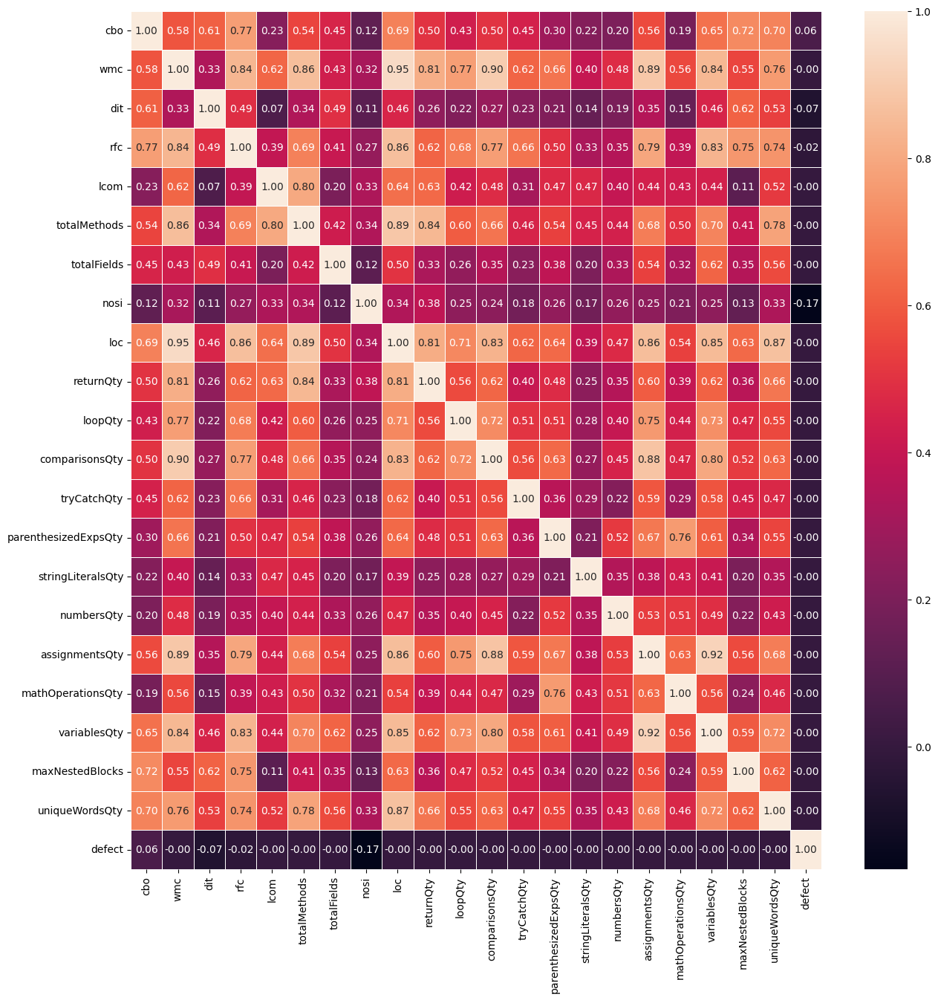

In [ ]:
f,ax = plt.subplots(figsize = (15, 15))
sns.heatmap(data.corr(), annot = True, linewidths = .5, fmt = '.2f')
plt.show()

In [ ]:
trace = go.Scatter(
    x = data.lcom,
    y = data.cbo,
    mode = "markers",
    name = "Volume - Bug",
    marker = dict(color = 'darkblue'),
    text = "Bug (b)")

scatter_data = [trace]
scatter_layout = dict(title = 'Volume - Bug',
              xaxis = dict(title = 'Volume', ticklen = 5),
              yaxis = dict(title = 'Bug' , ticklen = 5),
             )
# fig = dict(data = scatter_data, layout = scatter_layout)
# iplot(fig)
fig = go.Figure(data = scatter_data, layout = scatter_layout)
fig.show(renderer="colab")
#two attributes with high correlation v-b > just about 1

In [ ]:
data.isnull().sum() #shows how many of the null

cbo                     0
wmc                     0
dit                     0
rfc                     0
lcom                    0
totalMethods            0
totalFields             0
nosi                    0
loc                     0
returnQty               0
loopQty                 0
comparisonsQty          0
tryCatchQty             0
parenthesizedExpsQty    0
stringLiteralsQty       0
numbersQty              0
assignmentsQty          0
mathOperationsQty       0
variablesQty            0
maxNestedBlocks         0
uniqueWordsQty          0
defect                  0
dtype: int64

In [4]:
x=data.drop('defect',axis=1)
y=data['defect']

In [6]:
# from imblearn.combine import SMOTETomek
# sm=SMOTETomek(random_state=42)
# X,Y=sm.fit_resample(x,y)
# print("x shape : ",x.shape)
# print("X shape : ",X.shape)
# print("y shape : ",y.shape)
# print("Y shape : ",Y.shape)
xtrain,xtest,ytain,ytest=train_test_split(x,y,train_size=.80,random_state=42)
print("xtrain shape : ",xtrain.shape)
print("xtest shape : ",xtest.shape)
print("ytain shape : ",ytain.shape)
print("ytest shape : ",ytest.shape)
y.value_counts()

xtrain shape :  (4841, 21)
xtest shape :  (1211, 21)
ytain shape :  (4841,)
ytest shape :  (1211,)


0    3026
1    3026
Name: defect, dtype: int64

In [7]:
l = []
def metrics(model_name, y_pred_test_x,score):
    mean = mean_absolute_error(ytest, y_pred_test_x)
    r2 = r2_score(ytest, y_pred_test_x)

    rmse = mean_squared_error(ytest, y_pred_test_x, squared=False)
    explained_variance = explained_variance_score(ytest, y_pred_test_x, sample_weight=None, multioutput='uniform_average')
    max_error_ = max_error(ytest, y_pred_test_x)
    d2_tweedie_score_ = d2_tweedie_score(ytest, y_pred_test_x)


    print("Mean Absolute Error: ",mean )
    print("Mean Squared Error: ",rmse )
    print("R2 score: ",r2 )
    print("Explained Variance: ",explained_variance )
    print("max_error: ",max_error_ )
    print("d2_tweedie_score: ",d2_tweedie_score_ )
    print("Prediction Score  (PS):: ", score)

    l.append([model_name,score,  mean,rmse,  r2,explained_variance,max_error_ ,d2_tweedie_score_])


In [8]:
from sklearn.ensemble import RandomForestRegressor
modelRFR = RandomForestRegressor(n_estimators = 100, random_state = 0)
modelRFR.fit(xtrain, ytain)
metrics("Random Forest Regressor",modelRFR.predict(xtest),modelRFR.score(xtrain, ytain))

df1 = pd.DataFrame(l, columns=["Model Name", "Score", "mean", "rmse","r2","explained_variance","max_error","d2_tweedie_score"])
df1

Mean Absolute Error:  0.355683811096693
Mean Squared Error:  0.46117257823379715
R2 score:  0.14918136509200852
Explained Variance:  0.14919003210066595
max_error:  1.0
d2_tweedie_score:  0.14918136509200852
Prediction Score  (PS)::  0.8570135272518675


,Model Name,Score,mean,rmse,r2,explained_variance,max_error,d2_tweedie_score
0,Random Forest Regressor,0.857014,0.355684,0.461173,0.149181,0.14919,1.0,0.149181


In [9]:
#Creation of Linear Regression model
from sklearn.linear_model import LinearRegression
modelLR = LinearRegression()
modelLR.fit(xtrain, ytain)
metrics("Linear Regression",modelLR.predict(xtest),modelLR.score(xtrain, ytain))

df1 = pd.DataFrame(l, columns=["Model Name", "Score", "mean", "rmse","r2","explained_variance","max_error","d2_tweedie_score"])
df1

Mean Absolute Error:  0.4779783125496271
Mean Squared Error:  0.4894028909305997
R2 score:  0.041828822976995195
Explained Variance:  0.04193238365868823
max_error:  2.148850110079106
d2_tweedie_score:  0.041828822976995306
Prediction Score  (PS)::  0.0666771586037449


,Model Name,Score,mean,rmse,r2,explained_variance,max_error,d2_tweedie_score
0,Random Forest Regressor,0.857014,0.355684,0.461173,0.149181,0.149190,1.00000,0.149181
1,Linear Regression,0.066677,0.477978,0.489403,0.041829,0.041932,2.14885,0.041829


In [10]:
#Creation of Naive Bayes model
from sklearn.naive_bayes import GaussianNB
modelGNB = GaussianNB()
modelGNB.fit(xtrain, ytain)
metrics("Naive Bayes",modelGNB.predict(xtest),modelGNB.score(xtrain, ytain))

y_pred = modelGNB.predict(xtest)
#Summary of the predictions made by the classifier
print(classification_report(ytest , y_pred))
print(confusion_matrix(ytest , y_pred))
df1 = pd.DataFrame(l, columns=["Model Name", "Score", "mean", "rmse","r2","explained_variance","max_error","d2_tweedie_score"])
df1


Mean Absolute Error:  0.47398843930635837
Mean Squared Error:  0.6884681832200805
R2 score:  -0.896172269686951
Explained Variance:  -0.26767379183170203
max_error:  1
d2_tweedie_score:  -0.896172269686951
Prediction Score  (PS)::  0.5362528403222475
              precision    recall  f1-score   support

           0       0.64      0.14      0.23       612
           1       0.51      0.92      0.66       599

    accuracy                           0.53      1211
   macro avg       0.58      0.53      0.44      1211
weighted avg       0.58      0.53      0.44      1211

[[ 85 527]
 [ 47 552]]


,Model Name,Score,mean,rmse,r2,explained_variance,max_error,d2_tweedie_score
0,Random Forest Regressor,0.857014,0.355684,0.461173,0.149181,0.149190,1.00000,0.149181
1,Linear Regression,0.066677,0.477978,0.489403,0.041829,0.041932,2.14885,0.041829
2,Naive Bayes,0.536253,0.473988,0.688468,-0.896172,-0.267674,1.00000,-0.896172


In [11]:
#Creation of DecisionTreeClassifier
from sklearn.tree import DecisionTreeClassifier
modelDTC = DecisionTreeClassifier()
modelDTC.fit(xtrain, ytain)
metrics("DecisionTreeClassifier",modelDTC.predict(xtest),modelDTC.score(xtrain, ytain))

y_pred = modelDTC.predict(xtest)
#Summary of the predictions made by the classifier
print(classification_report(ytest , y_pred))
print(confusion_matrix(ytest , y_pred))

df1 = pd.DataFrame(l, columns=["Model Name", "Score", "mean", "rmse","r2","explained_variance","max_error","d2_tweedie_score"])
df1

Mean Absolute Error:  0.36416184971098264
Mean Squared Error:  0.603458241894982
R2 score:  -0.4568152803692429
Explained Variance:  -0.45620151232446227
max_error:  1
d2_tweedie_score:  -0.4568152803692427
Prediction Score  (PS)::  0.9801693864903945
              precision    recall  f1-score   support

           0       0.64      0.65      0.64       612
           1       0.64      0.62      0.63       599

    accuracy                           0.64      1211
   macro avg       0.64      0.64      0.64      1211
weighted avg       0.64      0.64      0.64      1211

[[399 213]
 [228 371]]


,Model Name,Score,mean,rmse,r2,explained_variance,max_error,d2_tweedie_score
0,Random Forest Regressor,0.857014,0.355684,0.461173,0.149181,0.149190,1.00000,0.149181
1,Linear Regression,0.066677,0.477978,0.489403,0.041829,0.041932,2.14885,0.041829
2,Naive Bayes,0.536253,0.473988,0.688468,-0.896172,-0.267674,1.00000,-0.896172
3,DecisionTreeClassifier,0.980169,0.364162,0.603458,-0.456815,-0.456202,1.00000,-0.456815


In [12]:
#Creation of LogisticRegression
from sklearn.linear_model import LogisticRegression
modelLR = LogisticRegression()
modelLR.fit(xtrain, ytain)
metrics("LogisticRegression",modelLR.predict(xtest),modelLR.score(xtrain, ytain))

y_pred = modelLR.predict(xtest)
#Summary of the predictions made by the classifier
print(classification_report(ytest , y_pred))
print(confusion_matrix(ytest , y_pred))

df1 = pd.DataFrame(l, columns=["Model Name", "Score", "mean", "rmse","r2","explained_variance","max_error","d2_tweedie_score"])
df1

Mean Absolute Error:  0.27580511973575556
Mean Squared Error:  0.5251715145890489
R2 score:  -0.10334762730913183
Explained Variance:  -0.06912937684812359
max_error:  1
d2_tweedie_score:  -0.1033476273091316
Prediction Score  (PS)::  0.7052261929353439
              precision    recall  f1-score   support

           0       0.78      0.64      0.70       612
           1       0.69      0.81      0.75       599

    accuracy                           0.72      1211
   macro avg       0.73      0.73      0.72      1211
weighted avg       0.73      0.72      0.72      1211

[[389 223]
 [111 488]]


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



,Model Name,Score,mean,rmse,r2,explained_variance,max_error,d2_tweedie_score
0,Random Forest Regressor,0.857014,0.355684,0.461173,0.149181,0.149190,1.00000,0.149181
1,Linear Regression,0.066677,0.477978,0.489403,0.041829,0.041932,2.14885,0.041829
2,Naive Bayes,0.536253,0.473988,0.688468,-0.896172,-0.267674,1.00000,-0.896172
3,DecisionTreeClassifier,0.980169,0.364162,0.603458,-0.456815,-0.456202,1.00000,-0.456815
4,LogisticRegression,0.705226,0.275805,0.525172,-0.103348,-0.069129,1.00000,-0.103348


In [13]:
#Creation of KNeighborsClassifier
from sklearn.neighbors import KNeighborsClassifier
modelKNC = KNeighborsClassifier(n_neighbors=5, metric='minkowski', p=2 )
modelKNC.fit(xtrain, ytain)
metrics("KNeighborsClassifier",modelKNC.predict(xtest),modelKNC.score(xtrain, ytain))

y_pred = modelKNC.predict(xtest)
#Summary of the predictions made by the classifier
print(classification_report(ytest , y_pred))
print(confusion_matrix(ytest , y_pred))

df1 = pd.DataFrame(l, columns=["Model Name", "Score", "mean", "rmse","r2","explained_variance","max_error","d2_tweedie_score"])
df1

Mean Absolute Error:  0.7093311312964492
Mean Squared Error:  0.842217983242135
R2 score:  -1.8376515325106113
Explained Variance:  -1.8335024605278951
max_error:  1
d2_tweedie_score:  -1.8376515325106113
Prediction Score  (PS)::  0.6033877298078909
              precision    recall  f1-score   support

           0       0.28      0.27      0.28       612
           1       0.30      0.32      0.31       599

    accuracy                           0.29      1211
   macro avg       0.29      0.29      0.29      1211
weighted avg       0.29      0.29      0.29      1211

[[163 449]
 [410 189]]


,Model Name,Score,mean,rmse,r2,explained_variance,max_error,d2_tweedie_score
0,Random Forest Regressor,0.857014,0.355684,0.461173,0.149181,0.149190,1.00000,0.149181
1,Linear Regression,0.066677,0.477978,0.489403,0.041829,0.041932,2.14885,0.041829
2,Naive Bayes,0.536253,0.473988,0.688468,-0.896172,-0.267674,1.00000,-0.896172
3,DecisionTreeClassifier,0.980169,0.364162,0.603458,-0.456815,-0.456202,1.00000,-0.456815
4,LogisticRegression,0.705226,0.275805,0.525172,-0.103348,-0.069129,1.00000,-0.103348
5,KNeighborsClassifier,0.603388,0.709331,0.842218,-1.837652,-1.833502,1.00000,-1.837652


In [14]:
#Creation of AdaBoostRegressor
from sklearn.ensemble import AdaBoostClassifier
modelABC =AdaBoostClassifier()
modelABC.fit(xtrain, ytain)
metrics("AdaBoostClassifier",modelABC.predict(xtest),modelABC.score(xtrain, ytain))

y_pred = modelABC.predict(xtest)
#Summary of the predictions made by the classifier
print(classification_report(ytest , y_pred))
print(confusion_matrix(ytest , y_pred))

df1 = pd.DataFrame(l, columns=["Model Name", "Score", "mean", "rmse","r2","explained_variance","max_error","d2_tweedie_score"])
df1

Mean Absolute Error:  0.2138728323699422
Mean Squared Error:  0.4624638714212627
R2 score:  0.14441007343393675
Explained Variance:  0.16699946533983656
max_error:  1
d2_tweedie_score:  0.14441007343393675
Prediction Score  (PS)::  0.7874406114439165
              precision    recall  f1-score   support

           0       0.84      0.71      0.77       612
           1       0.75      0.86      0.80       599

    accuracy                           0.79      1211
   macro avg       0.79      0.79      0.79      1211
weighted avg       0.79      0.79      0.79      1211

[[437 175]
 [ 84 515]]


,Model Name,Score,mean,rmse,r2,explained_variance,max_error,d2_tweedie_score
0,Random Forest Regressor,0.857014,0.355684,0.461173,0.149181,0.149190,1.00000,0.149181
1,Linear Regression,0.066677,0.477978,0.489403,0.041829,0.041932,2.14885,0.041829
2,Naive Bayes,0.536253,0.473988,0.688468,-0.896172,-0.267674,1.00000,-0.896172
3,DecisionTreeClassifier,0.980169,0.364162,0.603458,-0.456815,-0.456202,1.00000,-0.456815
4,LogisticRegression,0.705226,0.275805,0.525172,-0.103348,-0.069129,1.00000,-0.103348
5,KNeighborsClassifier,0.603388,0.709331,0.842218,-1.837652,-1.833502,1.00000,-1.837652
6,AdaBoostClassifier,0.787441,0.213873,0.462464,0.144410,0.166999,1.00000,0.144410


In [15]:
#Creation of GradientBoostingClassifier
from sklearn.ensemble import GradientBoostingClassifier
modelGBC =GradientBoostingClassifier(random_state=0)
modelGBC.fit(xtrain, ytain)
metrics("GradientBoostingClassifier",modelGBC.predict(xtest),modelGBC.score(xtrain, ytain))

y_pred = modelGBC.predict(xtest)
#Summary of the predictions made by the classifier
print(classification_report(ytest , y_pred))
print(confusion_matrix(ytest , y_pred))
df1 = pd.DataFrame(l, columns=["Model Name", "Score", "mean", "rmse","r2","explained_variance","max_error","d2_tweedie_score"])
df1

Mean Absolute Error:  0.21882741535920727
Mean Squared Error:  0.46778992652600726
R2 score:  0.12458945737449123
Explained Variance:  0.13284122775431806
max_error:  1
d2_tweedie_score:  0.12458945737449123
Prediction Score  (PS)::  0.8087172071885974
              precision    recall  f1-score   support

           0       0.81      0.74      0.77       612
           1       0.76      0.82      0.79       599

    accuracy                           0.78      1211
   macro avg       0.78      0.78      0.78      1211
weighted avg       0.78      0.78      0.78      1211

[[452 160]
 [105 494]]


,Model Name,Score,mean,rmse,r2,explained_variance,max_error,d2_tweedie_score
0,Random Forest Regressor,0.857014,0.355684,0.461173,0.149181,0.149190,1.00000,0.149181
1,Linear Regression,0.066677,0.477978,0.489403,0.041829,0.041932,2.14885,0.041829
2,Naive Bayes,0.536253,0.473988,0.688468,-0.896172,-0.267674,1.00000,-0.896172
3,DecisionTreeClassifier,0.980169,0.364162,0.603458,-0.456815,-0.456202,1.00000,-0.456815
4,LogisticRegression,0.705226,0.275805,0.525172,-0.103348,-0.069129,1.00000,-0.103348
5,KNeighborsClassifier,0.603388,0.709331,0.842218,-1.837652,-1.833502,1.00000,-1.837652
6,AdaBoostClassifier,0.787441,0.213873,0.462464,0.144410,0.166999,1.00000,0.144410
7,GradientBoostingClassifier,0.808717,0.218827,0.467790,0.124589,0.132841,1.00000,0.124589


In [16]:
from sklearn.ensemble import GradientBoostingRegressor
estimator=[]
for i in range(1, 30):
    model = GradientBoostingRegressor(n_estimators=i, random_state=42)
    model.fit(xtrain, ytain)
    score = model.score(xtrain, ytain)
    estimator.append(score)

(estimator.index(max(estimator)))+1

29

In [17]:
from sklearn.ensemble import GradientBoostingRegressor
modelGBRR = GradientBoostingRegressor(n_estimators= 17, random_state=42)

modelGBRR.fit(xtrain, ytain)
metrics("Optimized GRADIENT",modelGBRR.predict(xtest),modelGBRR.score(xtrain, ytain))
df1 = pd.DataFrame(l, columns=["Model Name", "Score", "mean", "rmse","r2","explained_variance","max_error","d2_tweedie_score"])
df1

Mean Absolute Error:  0.3467344863231616
Mean Squared Error:  0.39946894592770604
R2 score:  0.3616246794040643
Explained Variance:  0.36169859969655394
max_error:  0.8394096550000673
d2_tweedie_score:  0.3616246794040643
Prediction Score  (PS)::  0.3804821080511145


,Model Name,Score,mean,rmse,r2,explained_variance,max_error,d2_tweedie_score
0,Random Forest Regressor,0.857014,0.355684,0.461173,0.149181,0.149190,1.00000,0.149181
1,Linear Regression,0.066677,0.477978,0.489403,0.041829,0.041932,2.14885,0.041829
2,Naive Bayes,0.536253,0.473988,0.688468,-0.896172,-0.267674,1.00000,-0.896172
3,DecisionTreeClassifier,0.980169,0.364162,0.603458,-0.456815,-0.456202,1.00000,-0.456815
4,LogisticRegression,0.705226,0.275805,0.525172,-0.103348,-0.069129,1.00000,-0.103348
5,KNeighborsClassifier,0.603388,0.709331,0.842218,-1.837652,-1.833502,1.00000,-1.837652
6,AdaBoostClassifier,0.787441,0.213873,0.462464,0.144410,0.166999,1.00000,0.144410
7,GradientBoostingClassifier,0.808717,0.218827,0.467790,0.124589,0.132841,1.00000,0.124589
8,Optimized GRADIENT,0.380482,0.346734,0.399469,0.361625,0.361699,0.83941,0.361625


In [18]:
import xgboost
modelXGBR = xgboost.XGBRFRegressor()
modelXGBR.fit(xtrain, ytain)
metrics("XGBRFRegressor",modelXGBR.predict(xtest),modelXGBR.score(xtrain, ytain))
df1 = pd.DataFrame(l, columns=["Model Name", "Score", "mean", "rmse","r2","explained_variance","max_error","d2_tweedie_score"])
df1

Mean Absolute Error:  0.3142657421135538
Mean Squared Error:  0.3986553110446743
R2 score:  0.3642225057201046
Explained Variance:  0.3642705657254437
max_error:  0.933991014957428
d2_tweedie_score:  0.3642225057201046
Prediction Score  (PS)::  0.44610818676424113


,Model Name,Score,mean,rmse,r2,explained_variance,max_error,d2_tweedie_score
0,Random Forest Regressor,0.857014,0.355684,0.461173,0.149181,0.149190,1.000000,0.149181
1,Linear Regression,0.066677,0.477978,0.489403,0.041829,0.041932,2.148850,0.041829
2,Naive Bayes,0.536253,0.473988,0.688468,-0.896172,-0.267674,1.000000,-0.896172
3,DecisionTreeClassifier,0.980169,0.364162,0.603458,-0.456815,-0.456202,1.000000,-0.456815
4,LogisticRegression,0.705226,0.275805,0.525172,-0.103348,-0.069129,1.000000,-0.103348
5,KNeighborsClassifier,0.603388,0.709331,0.842218,-1.837652,-1.833502,1.000000,-1.837652
6,AdaBoostClassifier,0.787441,0.213873,0.462464,0.144410,0.166999,1.000000,0.144410
7,GradientBoostingClassifier,0.808717,0.218827,0.467790,0.124589,0.132841,1.000000,0.124589
8,Optimized GRADIENT,0.380482,0.346734,0.399469,0.361625,0.361699,0.839410,0.361625
9,XGBRFRegressor,0.446108,0.314266,0.398655,0.364223,0.364271,0.933991,0.364223


In [19]:
#Creation of XGBoost Classifier
import xgboost
from xgboost import XGBClassifier
modelXGBCC=XGBClassifier()
modelXGBCC.fit(xtrain, ytain)
metrics("XGBoost Classifier",modelXGBCC.predict(xtest),modelXGBCC.score(xtrain, ytain))

y_pred = modelXGBCC.predict(xtest)
#Summary of the predictions made by the classifier
print(classification_report(ytest , y_pred))
print(confusion_matrix(ytest , y_pred))
df1 = pd.DataFrame(l, columns=["Model Name", "Score", "mean", "rmse","r2","explained_variance","max_error","d2_tweedie_score"])
df1

Mean Absolute Error:  0.2947976878612717
Mean Squared Error:  0.5429527491976366
R2 score:  -0.1793266555370061
Explained Variance:  -0.17886564753892675
max_error:  1
d2_tweedie_score:  -0.1793266555370061
Prediction Score  (PS)::  0.9409212972526337
              precision    recall  f1-score   support

           0       0.71      0.70      0.71       612
           1       0.70      0.71      0.71       599

    accuracy                           0.71      1211
   macro avg       0.71      0.71      0.71      1211
weighted avg       0.71      0.71      0.71      1211

[[427 185]
 [172 427]]


,Model Name,Score,mean,rmse,r2,explained_variance,max_error,d2_tweedie_score
0,Random Forest Regressor,0.857014,0.355684,0.461173,0.149181,0.149190,1.000000,0.149181
1,Linear Regression,0.066677,0.477978,0.489403,0.041829,0.041932,2.148850,0.041829
2,Naive Bayes,0.536253,0.473988,0.688468,-0.896172,-0.267674,1.000000,-0.896172
3,DecisionTreeClassifier,0.980169,0.364162,0.603458,-0.456815,-0.456202,1.000000,-0.456815
4,LogisticRegression,0.705226,0.275805,0.525172,-0.103348,-0.069129,1.000000,-0.103348
5,KNeighborsClassifier,0.603388,0.709331,0.842218,-1.837652,-1.833502,1.000000,-1.837652
6,AdaBoostClassifier,0.787441,0.213873,0.462464,0.144410,0.166999,1.000000,0.144410
7,GradientBoostingClassifier,0.808717,0.218827,0.467790,0.124589,0.132841,1.000000,0.124589
8,Optimized GRADIENT,0.380482,0.346734,0.399469,0.361625,0.361699,0.839410,0.361625
9,XGBRFRegressor,0.446108,0.314266,0.398655,0.364223,0.364271,0.933991,0.364223


In [20]:
#Creation of ExtraTreesClassifier
from sklearn.ensemble import ExtraTreesClassifier
modelETCC=ExtraTreesClassifier()
modelETCC.fit(xtrain, ytain)
metrics("ExtraTreesClassifier",modelETCC.predict(xtest),modelETCC.score(xtrain, ytain))

y_pred = modelETCC.predict(xtest)
#Summary of the predictions made by the classifier
print(classification_report(ytest , y_pred))
print(confusion_matrix(ytest , y_pred))

df1 = pd.DataFrame(l, columns=["Model Name", "Score", "mean", "rmse","r2","explained_variance","max_error","d2_tweedie_score"])
df1

Mean Absolute Error:  0.365813377374071
Mean Squared Error:  0.6048250799810396
R2 score:  -0.46342215238905804
Explained Variance:  -0.4629611443909787
max_error:  1
d2_tweedie_score:  -0.4634221523890578
Prediction Score  (PS)::  0.9801693864903945
              precision    recall  f1-score   support

           0       0.64      0.65      0.64       612
           1       0.63      0.62      0.63       599

    accuracy                           0.63      1211
   macro avg       0.63      0.63      0.63      1211
weighted avg       0.63      0.63      0.63      1211

[[397 215]
 [228 371]]


,Model Name,Score,mean,rmse,r2,explained_variance,max_error,d2_tweedie_score
0,Random Forest Regressor,0.857014,0.355684,0.461173,0.149181,0.149190,1.000000,0.149181
1,Linear Regression,0.066677,0.477978,0.489403,0.041829,0.041932,2.148850,0.041829
2,Naive Bayes,0.536253,0.473988,0.688468,-0.896172,-0.267674,1.000000,-0.896172
3,DecisionTreeClassifier,0.980169,0.364162,0.603458,-0.456815,-0.456202,1.000000,-0.456815
4,LogisticRegression,0.705226,0.275805,0.525172,-0.103348,-0.069129,1.000000,-0.103348
5,KNeighborsClassifier,0.603388,0.709331,0.842218,-1.837652,-1.833502,1.000000,-1.837652
6,AdaBoostClassifier,0.787441,0.213873,0.462464,0.144410,0.166999,1.000000,0.144410
7,GradientBoostingClassifier,0.808717,0.218827,0.467790,0.124589,0.132841,1.000000,0.124589
8,Optimized GRADIENT,0.380482,0.346734,0.399469,0.361625,0.361699,0.839410,0.361625
9,XGBRFRegressor,0.446108,0.314266,0.398655,0.364223,0.364271,0.933991,0.364223


In [21]:
from sklearn.svm import SVR
modelSVR = SVR(kernel = 'rbf')
modelSVR.fit(xtrain, ytain)
metrics("SVR",modelSVR.predict(xtest),modelSVR.score(xtrain, ytain))

df1 = pd.DataFrame(l, columns=["Model Name", "Score", "mean", "rmse","r2","explained_variance","max_error","d2_tweedie_score"])
df1


Mean Absolute Error:  0.5106099844142342
Mean Squared Error:  0.6275910776149427
R2 score:  -0.5756638202862319
Explained Variance:  -0.0755781935578379
max_error:  0.924031587362151
d2_tweedie_score:  -0.5756638202862319
Prediction Score  (PS)::  -0.5098402592693225


,Model Name,Score,mean,rmse,r2,explained_variance,max_error,d2_tweedie_score
0,Random Forest Regressor,0.857014,0.355684,0.461173,0.149181,0.149190,1.000000,0.149181
1,Linear Regression,0.066677,0.477978,0.489403,0.041829,0.041932,2.148850,0.041829
2,Naive Bayes,0.536253,0.473988,0.688468,-0.896172,-0.267674,1.000000,-0.896172
3,DecisionTreeClassifier,0.980169,0.364162,0.603458,-0.456815,-0.456202,1.000000,-0.456815
4,LogisticRegression,0.705226,0.275805,0.525172,-0.103348,-0.069129,1.000000,-0.103348
5,KNeighborsClassifier,0.603388,0.709331,0.842218,-1.837652,-1.833502,1.000000,-1.837652
6,AdaBoostClassifier,0.787441,0.213873,0.462464,0.144410,0.166999,1.000000,0.144410
7,GradientBoostingClassifier,0.808717,0.218827,0.467790,0.124589,0.132841,1.000000,0.124589
8,Optimized GRADIENT,0.380482,0.346734,0.399469,0.361625,0.361699,0.839410,0.361625
9,XGBRFRegressor,0.446108,0.314266,0.398655,0.364223,0.364271,0.933991,0.364223


In [22]:
df1 = pd.DataFrame(l, columns=["Model Name", "Score", "mean", "rmse","r2","explained_variance","max_error","d2_tweedie_score"])
df1

,Model Name,Score,mean,rmse,r2,explained_variance,max_error,d2_tweedie_score
0,Random Forest Regressor,0.857014,0.355684,0.461173,0.149181,0.149190,1.000000,0.149181
1,Linear Regression,0.066677,0.477978,0.489403,0.041829,0.041932,2.148850,0.041829
2,Naive Bayes,0.536253,0.473988,0.688468,-0.896172,-0.267674,1.000000,-0.896172
3,DecisionTreeClassifier,0.980169,0.364162,0.603458,-0.456815,-0.456202,1.000000,-0.456815
4,LogisticRegression,0.705226,0.275805,0.525172,-0.103348,-0.069129,1.000000,-0.103348
5,KNeighborsClassifier,0.603388,0.709331,0.842218,-1.837652,-1.833502,1.000000,-1.837652
6,AdaBoostClassifier,0.787441,0.213873,0.462464,0.144410,0.166999,1.000000,0.144410
7,GradientBoostingClassifier,0.808717,0.218827,0.467790,0.124589,0.132841,1.000000,0.124589
8,Optimized GRADIENT,0.380482,0.346734,0.399469,0.361625,0.361699,0.839410,0.361625
9,XGBRFRegressor,0.446108,0.314266,0.398655,0.364223,0.364271,0.933991,0.364223


In [24]:
!pip install lime
x.columns

Index(['cbo', 'wmc', 'dit', 'rfc', 'lcom', 'totalMethods', 'totalFields',
       'nosi', 'loc', 'returnQty', 'loopQty', 'comparisonsQty', 'tryCatchQty',
       'parenthesizedExpsQty', 'stringLiteralsQty', 'numbersQty',
       'assignmentsQty', 'mathOperationsQty', 'variablesQty',
       'maxNestedBlocks', 'uniqueWordsQty'],
      dtype='object')

In [25]:
feature_names = ['cbo', 'wmc', 'dit', 'rfc', 'lcom', 'totalMethods', 'totalFields',
       'nosi', 'loc', 'returnQty', 'loopQty', 'comparisonsQty', 'tryCatchQty',
       'parenthesizedExpsQty', 'stringLiteralsQty', 'numbersQty',
       'assignmentsQty', 'mathOperationsQty', 'variablesQty',
       'maxNestedBlocks', 'uniqueWordsQty']
features = np.array(feature_names)

In [27]:
import lime
import lime.lime_tabular
import numpy as np
explainer = lime.lime_tabular.LimeTabularExplainer(np.array(xtrain),
                                                   feature_names= x.columns,
                                                   class_names=['MEDV'],verbose=True, mode='regression')  # alternative regression/classification

In [28]:
explainer

In [30]:
xtest.shape

(1211, 21)

In [31]:
for i in range(1,20):
    print(i)
    exp = explainer.explain_instance(xtest.iloc[i], modelXGBR.predict, num_features=6)
    exp.show_in_notebook(show_table=True)

1
Intercept 0.5683954948178702
Prediction_local [0.23606304]
Right: 0.090997525


2
Intercept 0.5488175204105306
Prediction_local [0.14829705]
Right: 0.17221873


3
Intercept 0.15915469940036492
Prediction_local [0.77540616]
Right: 0.9037843


4
Intercept 0.18591597211182181
Prediction_local [0.7023997]
Right: 0.75850093


5
Intercept 0.18320578853807234
Prediction_local [0.71379864]
Right: 0.82210535


6
Intercept 0.5610636502396841
Prediction_local [0.26174275]
Right: 0.17826536


7
Intercept 0.17153523446987495
Prediction_local [0.73703586]
Right: 0.7235591


8
Intercept 0.24091109638294414
Prediction_local [0.56288048]
Right: 0.44030216


9
Intercept 0.5784634162282632
Prediction_local [0.2143821]
Right: 0.09949871


10
Intercept 0.20481899412655424
Prediction_local [0.64494314]
Right: 0.73971534


11
Intercept 0.5767859159112554
Prediction_local [0.10649123]
Right: 0.14514346


12
Intercept 0.20286826892400717
Prediction_local [0.64979848]
Right: 0.75653714


13
Intercept 0.5553088081353454
Prediction_local [0.15947387]
Right: 0.14586645


14
Intercept 0.25847356870477434
Prediction_local [0.52278406]
Right: 0.19141234


15
Intercept 0.2174092137050752
Prediction_local [0.61842748]
Right: 0.75350016


16
Intercept 0.22234621829685453
Prediction_local [0.59772663]
Right: 0.7390443


17
Intercept 0.1891914827614432
Prediction_local [0.70826876]
Right: 0.91463923


18
Intercept 0.22037659282477084
Prediction_local [0.64406238]
Right: 0.61453253


19
Intercept 0.6197026553418945
Prediction_local [0.09561506]
Right: 0.14517711


In [29]:
j = 5
# exp = explainer.explain_instance(X_test[j], rf_regressor.predict, num_features=6)
exp = explainer.explain_instance(xtest.iloc[j], modelRFR.predict, num_features=6)

# Show the predictions
exp.show_in_notebook(show_table=True)


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning:

X does not have valid feature names, but RandomForestRegressor was fitted with feature names



Intercept 0.35214360331412553
Prediction_local [0.59996524]
Right: 0.76


In [ ]:
exp.as_list()

[('0.00 < nosi <= 4.00', -0.1506735626226124),
 ('6.00 < comparisonsQty <= 23.00', 0.018309431125144958),
 ('numbersQty > 32.25', -0.01489040096074668),
 ('16.00 < cbo <= 29.00', 0.01339920182192972),
 ('2.00 < loopQty <= 7.00', 0.011775261652628856),
 ('44.00 < rfc <= 92.00', -0.010309749210008682)]

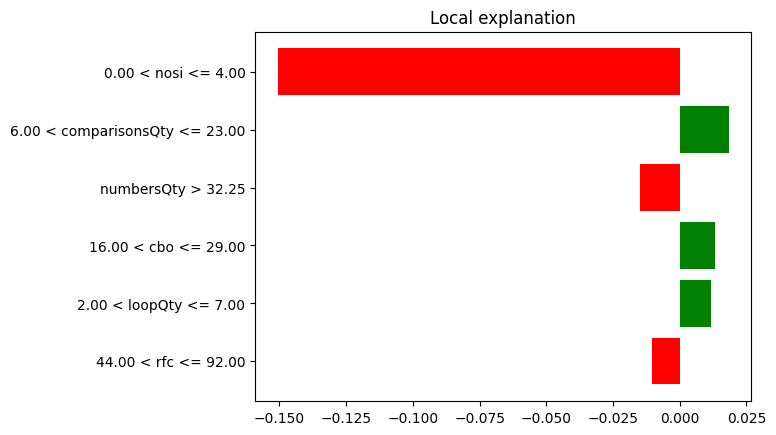

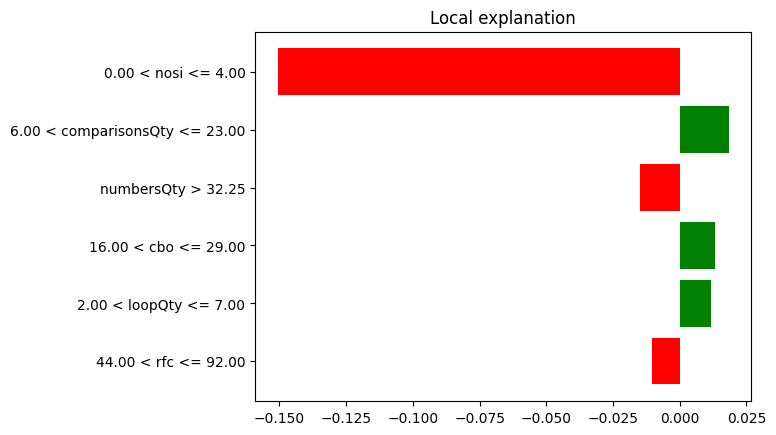

In [ ]:
exp.as_pyplot_figure()

In [ ]:
test = ytest
test = test.to_numpy()

In [ ]:
for i in range(1,5):
    # exp = explainer.explain_instance(X_test[i], rf_regressor.predict, num_features=6)
    exp = explainer.explain_instance(xtest.iloc[j], modelRFR.predict, num_features=6)
    print("Y True: ", test[i])
    # Show the predictions
    exp.show_in_notebook(show_table=True)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
methodsNames=[modelRFR,modelLR,modelGNB,modelDTC,modelLR,modelKNC,modelABC,modelGBC,modelGBRR,modelXGBR,modelXGBCC,modelETCC,modelSVR]

# position 1,2,3,4,5,6,11,12 now work for Shap
# !pip install shap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 572.6/572.6 kB 9.2 MB/s eta 0:00:00


In [ ]:
# import shap library
import shap

print(methodsNames[0])
explainer = shap.TreeExplainer(methodsNames[0])
shap_values = explainer.shap_values(xtrain)

# visualize the first prediction's explanation
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[0,:], xtrain.iloc[0,:])

RandomForestRegressor(random_state=0)


In [ ]:
# position 1,2,3,4,5,6, now work
print(methodsNames[7])
explainer = shap.TreeExplainer(methodsNames[7])
shap_values = explainer.shap_values(xtrain)

# visualize the first prediction's explanation
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[0,:], xtrain.iloc[0,:])

GradientBoostingClassifier(random_state=0)


In [ ]:
# position 1,2,3,4,5,6, now work
print(methodsNames[8])
explainer = shap.TreeExplainer(methodsNames[8])
shap_values = explainer.shap_values(xtrain)

# visualize the first prediction's explanation
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[0,:], xtrain.iloc[0,:])

GradientBoostingRegressor(n_estimators=17, random_state=42)


In [ ]:
# position 1,2,3,4,5,6, now work
print(methodsNames[10])
explainer = shap.TreeExplainer(methodsNames[10])
shap_values = explainer.shap_values(xtrain)

# visualize the first prediction's explanation
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[0,:], xtrain.iloc[0,:])

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)


ntree_limit is deprecated, use `iteration_range` or model slicing instead.
